<a href="https://colab.research.google.com/github/RajbanulAkhond/Computational_ToolKit/blob/main/L_J_cluster_simulation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Lennard-Jone Clusters**

> In the CG algorithm to minimize the total energy of a cluster of particles which are interating through the Lennard-Jone analytic potential, the gradient can be estimated numerically. However, it is very slow and inefficient. On the other hand, a gradient function can be provided to make the process fast. Moreover, using Numpy vectorization the simulation can be made more effiecient. In this notebook the aforementioned optimization processes are implemented.



---



# **L-J Potential Function**

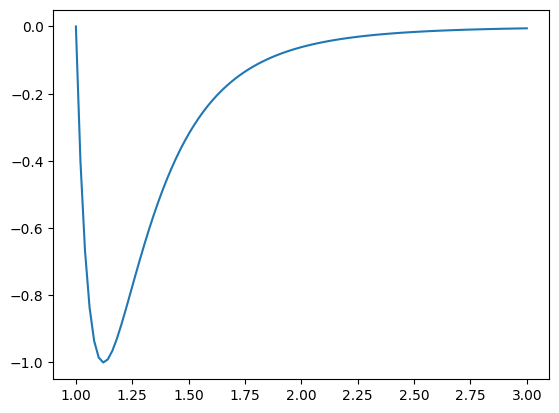

In [1]:
%matplotlib inline

import numpy as np
import matplotlib.pyplot as plt

def LJ(r):
  r6 = r**6
  r12 = r6*r6
  return 4*(1/r12 - 1/r6)

r = np.linspace (1.0,3.0,100)
plt.plot(r,LJ(r))
plt.show()

# **Symbolically Differentiate L-J Potential to Find Force**

In [2]:
from sympy import symbols, diff, lambdify, Matrix

# Define the variable
r = symbols('r')

# Define the Lennard-Jones potential function
LJ_f = 4*(1/r**12 - 1/r**6)

# Compute the derivative of the function
LJ_derivative = diff(LJ_f, r)

# Compute the negative of the derivative
negative_LJ_derivative = -LJ_derivative

print(negative_LJ_derivative)

-24/r**7 + 48/r**13


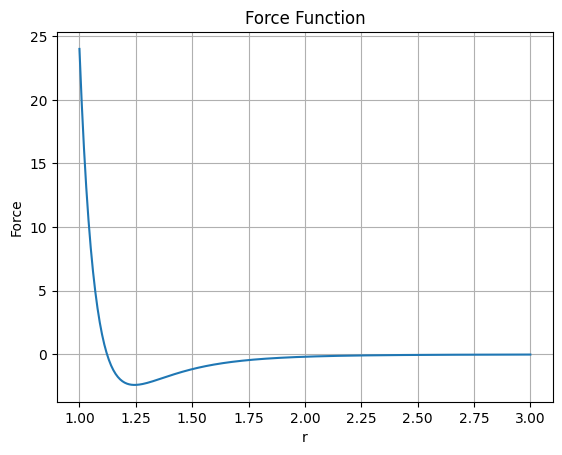

In [3]:
# Convert the symbolic expression into a function
LJ_force = lambdify(r, negative_LJ_derivative, "numpy")

# Generate x values
x = np.linspace(1, 3, 400)

# Compute y values
y = LJ_force(x)

# Create the plot
plt.plot(x, y)
plt.title('Force Function')
plt.xlabel('r')
plt.ylabel('Force')
plt.grid(True)
plt.show()

# **Initializing Positions and Energy Function**

In [4]:
from scipy.optimize import minimize, check_grad


# Initial positions of 38 particles
pos = np.array(
    [[9.1912408, 8.85347993, 2.52084286],
    [1.01912764, 3.87522545, 4.62970322],
    [5.24551702, 3.08277634, 7.05478086],
    [7.45460644, 1.82528748, 9.1244322],
    [2.23631807, 6.50856483, 8.17087062],
    [2.38413586, 2.45351112, 9.09679809],
    [3.89190792, 7.0473434,  8.64435811],
    [8.18056541, 5.82798785, 7.06721024],
    [7.77931597, 1.1913546,  8.189075],
    [6.01469145, 7.25783933, 2.85902436],
    [3.20436434, 6.12880544, 8.40349576],
    [1.17308183, 5.01219025, 5.18666853],
    [9.56018292, 8.35520658, 4.53423182],
    [8.96446002, 2.54045198, 1.18540885],
    [6.71330128, 1.47359293, 8.48820804],
    [7.76428251, 4.82036586, 6.64556474],
    [3.51015797, 6.52003299, 9.52943662],
    [6.36423462, 8.27639182, 3.20621038],
    [2.86670404, 7.02224667, 8.93137555],
    [9.66500032, 7.80058222, 6.18588381],
    [0.86644517, 6.0966345,  4.93413621],
    [0.51555606, 4.29384818, 3.60742217],
    [3.86087918, 2.44117332, 0.94168493],
    [9.53757102, 4.99027756, 9.32440563],
    [0.7141156,  7.10720338, 4.38772771],
    [6.92954254, 0.05736179, 4.72862505],
    [3.03575535, 7.41135827, 7.91044752],
    [4.54490467, 6.15200622, 9.18212839],
    [8.17499498, 1.06876349, 6.98880152],
    [8.80925458, 1.61273032, 1.76078201],
    [2.54396165, 1.3325331,  6.15136613],
    [6.22496233, 7.9443845,  2.08881114],
    [1.69322599, 6.85444596, 9.02678238],
    [6.53529894, 5.56049505, 0.42834861],
    [5.41818267, 8.17326036, 2.80320575],
    [6.37606463, 3.60233175, 3.17719802],
    [1.37927686, 3.51987394, 3.55278354],
    [1.32779946, 2.79836489, 4.6765608],]
    )


In [5]:
def distance(positions):
    r = []
    for i in range(len(positions)):
            for j in range(i+1, len(positions)):
                # Calculate distance between particles
                r = np.append(r, np.linalg.norm(positions[i] - positions[j]))
    return r

def total_energy(positions):
    # Initialize total energy
    total_energy = 0
    pos_rp =np.reshape(positions,(-1,3))
    distances = distance(pos_rp)
    # Calculate energy for each pair of particles
    for i in range(len(distances)):
            # Add the Lennard-Jones potential to the total energy
            total_energy += LJ(distances[i])

    return total_energy


# Vectorized Energy Function

In [14]:
def distance_v(positions):

    num_particles = positions.shape[0]
    indices = np.triu_indices(num_particles, k=1)
    particle_pairs = positions[indices[0]] - positions[indices[1]]
    distances = np.linalg.norm(particle_pairs, axis=1)

    return distances

def total_energy_v(positions):

    pos_rp =np.reshape(positions,(-1,3))
    # Calculate distances between particles
    distances = distance_v(pos_rp)

    # Calculate Lennard-Jones potential for each pair
    lj_potentials = LJ(distances)

    # Calculate total energy
    total_energy = np.sum(lj_potentials)

    return total_energy

In [15]:
%%time
pos_ft = pos.flatten()
print("Initial energy:", total_energy_v(pos_ft))

Initial energy: -32.809489222835616
CPU times: user 1.19 ms, sys: 963 µs, total: 2.15 ms
Wall time: 1.66 ms


# **Minimizing Energy with Numerical Gradient**

In [16]:
%%time
#Minimize the energy with numerical gradient
res = minimize(total_energy, pos_ft, method='CG', tol=1e-3)

print("After minimization:", res.fun)

After minimization: -167.51694494330886
CPU times: user 48min 3s, sys: 1min 49s, total: 49min 53s
Wall time: 49min 8s


In [17]:
%%time
#Minimize the energy with numerical gradient and vectorized energy function
res_v = minimize(total_energy_v, pos_ft, method='CG', tol=1e-3)

print("After minimization:", res_v.fun)

After minimization: -167.24910301242767
CPU times: user 1min 1s, sys: 151 ms, total: 1min 1s
Wall time: 1min 2s


# **Minimizing Energy With Custom Gradient (Force) Function**

In [18]:
def gradient(positions):
    pos_rp = np.reshape(positions, (-1, 3))
    n = len(pos_rp)
    grad = np.zeros_like(positions)

    for i in range(n):
        for j in range(i + 1, n):
            # Calculate distance vector between two particles
            diff = pos_rp[i] - pos_rp[j]
            r = np.linalg.norm(diff)
            normalized_diff = diff / r #normalize distance vector
            force = -LJ_force(r)*normalized_diff #vectorize the force

            #accumulate the force into the gradient vector
            grad[i*3:i*3+3] += force
            grad[j*3:j*3+3] -= force #Newton's Third Law (F1 = -F2)

    return grad

In [29]:
#Vectorized gradient function
def gradient_v(positions):
    pos_rp = np.reshape(positions, (-1, 3))
    n = len(pos_rp)
    grad = np.zeros_like(positions)

    # Create arrays for pairwise differences and distances
    pairwise_diff = pos_rp[:, np.newaxis, :] - pos_rp
    distances = np.linalg.norm(pairwise_diff, axis=2)

    # Avoid division by zero by adding a small epsilon
    epsilon = 1e-12
    distances += epsilon

    # Calculate the normalized difference vectors
    normalized_diff = pairwise_diff / distances[:, :, np.newaxis]

    # Calculate the LJ forces for all pairs of particles
    forces = -LJ_force(distances)[:, :, np.newaxis] * normalized_diff

    # Calculate the total force on each particle by summing the forces
    grad = np.sum(forces, axis=1)

    return grad.ravel()

In [24]:
# Calculate the maximum absolute error between the analytical gradient and the numerical gradient
gradient_error = check_grad(total_energy_v, gradient_v, pos_ft)

print(f"Maximum gradient error: {gradient_error:.8f}")

Maximum gradient error: 0.00000552


In [25]:
%%time
#minimize the energy using force function
res_jac = minimize(total_energy, pos_ft, jac=gradient, method='CG', tol=1e-3)

print("After minimization using jac:", res_jac.fun)

After minimization using jac: -163.6275925791586
CPU times: user 46.5 s, sys: 2.07 s, total: 48.6 s
Wall time: 49 s


In [26]:
%%time
#minimize the energy using vecorized force function
res_jac_v = minimize(total_energy_v, pos_ft, jac=gradient_v, method='CG', tol=1e-3)

print("After minimization using jac:", res_jac_v.fun)

After minimization using jac: -169.43863788293538
CPU times: user 1.37 s, sys: 3.72 ms, total: 1.38 s
Wall time: 1.39 s


# **Interactive PLot**

In [27]:
import plotly.express as px
import pandas as pd

pos_final = res_jac_v.x.reshape((-1, 3))
# Create a DataFrame from the positions array
df = pd.DataFrame(pos_final, columns=['X', 'Y', 'Z'])

# Create an interactive 3D scatter plot
fig = px.scatter_3d(df, x='X', y='Y', z='Z')

# Customize the plot (optional)
fig.update_traces(marker=dict(size=5, opacity=0.6))

# Show the plot
fig.show()

# **Animation**

In [28]:
# Create a function to record positions during optimization
recorded_positions = []

def record_positions(x):
    global recorded_positions
    recorded_positions.append(x.copy())

# Define the optimization callback function
def optimization_callback(intermediate_result):
    record_positions(intermediate_result.x)

# Create a minimize function with the callback
res_cl = minimize(total_energy_v, pos_ft, jac=gradient_v, method='CG', tol=1e-3, callback=optimization_callback)

# Convert recorded positions to a NumPy array
recorded_positions = np.array(recorded_positions)


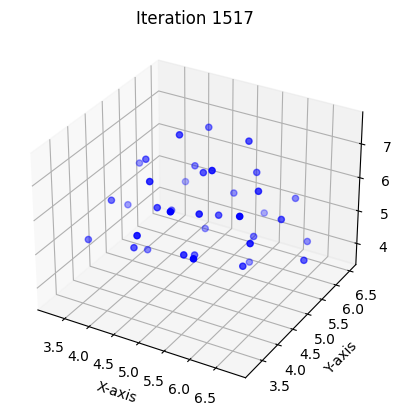

In [ ]:
from matplotlib import animation, rc

iterations = len(recorded_positions)

# Create a 3D plot
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Set axis labels and title
ax.set_xlabel('X-axis')
ax.set_ylabel('Y-axis')
ax.set_zlabel('Z-axis')
ax.set_title('Optimization Process')

# Define the desired axis ranges
x_min, x_max = 0, 10
y_min, y_max = 0, 10
z_min, z_max = 0, 10

# Set the axis limits
ax.set_xlim(x_min, x_max)
ax.set_ylim(y_min, y_max)
ax.set_zlim(z_min, z_max)

# Function to update the plot during animation
def update_plot(iteration):
    ax.cla()  # Clear the current plot
    rp = recorded_positions[iteration].reshape((-1, 3))
    ax.scatter(rp[:, 0], rp[:, 1], rp[:, 2], c='b', marker='o')
    ax.set_xlabel('X-axis')
    ax.set_ylabel('Y-axis')
    ax.set_zlabel('Z-axis')
    ax.set_title(f'Iteration {iteration}')

# Create an animation using recorded positions
anim = animation.FuncAnimation(fig, update_plot, frames=iterations, interval=50)

# To save the animation as a video
#anim.save('particle_positions_animation.mp4', writer='ffmpeg')

# To display the animation (only shows partial animations due to size restriction)
rc('animation', html='jshtml')
anim